In [74]:
from isochrones.dartmouth import Dartmouth_Isochrone
dar = Dartmouth_Isochrone()

2 stars physically bound wih mass 0.5Msun, 1.5Msun. Another separate star with mass 1.0Msun

In [75]:
from isochrones.utils import addmags
import numpy as np
M1 = 1.5
M2 = 0.5
M3 = 1.0
age1 = np.log10(5e8)
age3 = np.log10(5e9)
feh = 0.0
distance1 = 300
distance3 = 500
AV = 0.1

unresolved_bands = ['i','J','H','K','W1','W2']
resolved_bands = ['i','J','K']
args1 = (age1, feh, distance1, AV)
args3 = (age3, feh, distance3, AV)
unresolved = {b:addmags(dar.mag[b](M1, *args1), dar.mag[b](M2, *args1), dar.mag[b](M3, *args3)) for b in unresolved_bands}
resolved_1 = {b:dar.mag[b](M1, *args1) for b in resolved_bands}
resolved_2 = {b:dar.mag[b](M2, *args1) for b in resolved_bands}
resolved_3 = {b:dar.mag[b](M3, *args3) for b in resolved_bands}

In [76]:
unresolved, resolved_1, resolved_2, resolved_3

({'H': 9.4150873209332282,
  'J': 9.5835010071697067,
  'K': 9.3829386004395285,
  'W1': 9.3715419441754726,
  'W2': 9.3672710453183541,
  'i': 10.242333925734332},
 {'J': 9.7131141237241412, 'K': 9.5486762976776376, 'i': 10.336472754458542},
 {'J': 14.049417008014405, 'K': 13.215133317539811, 'i': 15.891532079071984},
 {'J': 12.125863050974678, 'K': 11.75744605477176, 'i': 13.018336915488094})

In [77]:
import pandas as pd

instruments = ['twomass','WISE','SDSS','RAO']
bands = {'twomass':['J','H','K'],
          'WISE':['W1','W2'],
          'SDSS':['i'],
          'RAO':['i','J','K']}
mag_unc = {'twomass': 0.02, 'WISE':0.02, 'SDSS':0.02, 'RAO':0.1}
resolution = {'twomass':4.0, 'WISE':5.0, 'SDSS':4.5, 'RAO':0.1}
relative = {'twomass':False, 'WISE':False, 'SDSS':False, 'RAO':True}
separation2 = 0.5
separation3 = 1.2
PA2, PA3 = 100.,45.

columns = ['name', 'band', 'resolution', 'relative', 'separation', 'pa', 'mag', 'e_mag']
df = pd.DataFrame(columns=columns)
i=0
for inst in ['twomass', 'WISE','SDSS']:  #Unresolved observations
    for b in bands[inst]:
        row = {}
        row['name'] = inst
        row['band'] = b
        row['resolution'] = resolution[inst]
        row['relative'] = relative[inst]
        row['separation'] = 0.
        row['pa'] = 0.
        row['mag'] = unresolved[b]
        row['e_mag'] = mag_unc[inst]
        df = df.append(pd.DataFrame(row, index=[i]))
        i += 1

for inst in ['RAO']:  #Resolved observations
    for b in bands[inst]:
        mags = [resolved_1[b], resolved_2[b], resolved_3[b]]
        pas = [0, PA2, PA3]
        seps = [0., separation2, separation3]
        for mag,sep,pa in zip(mags,seps,pas):
            row = {}
            row['name'] = inst
            row['band'] = b
            row['resolution'] = resolution[inst]
            row['relative'] = relative[inst]
            row['separation'] = sep
            row['pa'] = pa
            row['mag'] = mag
            row['e_mag'] = mag_unc[inst]
            df = df.append(pd.DataFrame(row, index=[i]))
            i += 1
            
df

,band,e_mag,mag,name,pa,relative,resolution,separation
0,J,0.02,9.583501,twomass,0.0,False,4.0,0.0
1,H,0.02,9.415087,twomass,0.0,False,4.0,0.0
2,K,0.02,9.382939,twomass,0.0,False,4.0,0.0
3,W1,0.02,9.371542,WISE,0.0,False,5.0,0.0
4,W2,0.02,9.367271,WISE,0.0,False,5.0,0.0
5,i,0.02,10.242334,SDSS,0.0,False,4.5,0.0
6,i,0.10,10.336473,RAO,0.0,True,0.1,0.0
7,i,0.10,15.891532,RAO,100.0,True,0.1,0.5
8,i,0.10,13.018337,RAO,45.0,True,0.1,1.2
9,J,0.10,9.713114,RAO,0.0,True,0.1,0.0


In [78]:
from isochrones.observation import ObservationTree

In [79]:
t = ObservationTree.from_df(df, name='test-triplet')
t.print_ascii()

test-triplet
 ╚═ WISE W1=(9.37, 0.02) @(0.00, 0 [5.00])
    ╚═ WISE W2=(9.37, 0.02) @(0.00, 0 [5.00])
       ╚═ SDSS i=(10.24, 0.02) @(0.00, 0 [4.50])
          ╚═ twomass H=(9.42, 0.02) @(0.00, 0 [4.00])
             ╚═ twomass J=(9.58, 0.02) @(0.00, 0 [4.00])
                ╚═ twomass K=(9.38, 0.02) @(0.00, 0 [4.00])
                   ╠═ RAO J=(9.71, 0.10) @(0.00, 0 [0.10])
                   ║  ╚═ RAO K=(9.55, 0.10) @(0.00, 0 [0.10])
                   ║     ╚═ RAO i=(10.34, 0.10) @(0.00, 0 [0.10])
                   ╠═ RAO J=(14.05, 0.10) @(0.50, 100 [0.10])
                   ║  ╚═ RAO K=(13.22, 0.10) @(0.50, 100 [0.10])
                   ║     ╚═ RAO i=(15.89, 0.10) @(0.50, 100 [0.10])
                   ╚═ RAO J=(12.13, 0.10) @(1.20, 45 [0.10])
                      ╚═ RAO K=(11.76, 0.10) @(1.20, 45 [0.10])
                         ╚═ RAO i=(13.02, 0.10) @(1.20, 45 [0.10])


In [80]:
t.define_models(dar)
t.print_ascii()

test-triplet
 ╚═ WISE W1=(9.37, 0.02) @(0.00, 0 [5.00])
    ╚═ WISE W2=(9.37, 0.02) @(0.00, 0 [5.00])
       ╚═ SDSS i=(10.24, 0.02) @(0.00, 0 [4.50])
          ╚═ twomass H=(9.42, 0.02) @(0.00, 0 [4.00])
             ╚═ twomass J=(9.58, 0.02) @(0.00, 0 [4.00])
                ╚═ twomass K=(9.38, 0.02) @(0.00, 0 [4.00])
                   ╠═ RAO J=(9.71, 0.10) @(0.00, 0 [0.10])
                   ║  ╚═ RAO K=(9.55, 0.10) @(0.00, 0 [0.10])
                   ║     ╚═ RAO i=(10.34, 0.10) @(0.00, 0 [0.10])
                   ║        ╚═ 0_0
                   ╠═ RAO J=(14.05, 0.10) @(0.50, 100 [0.10])
                   ║  ╚═ RAO K=(13.22, 0.10) @(0.50, 100 [0.10])
                   ║     ╚═ RAO i=(15.89, 0.10) @(0.50, 100 [0.10])
                   ║        ╚═ 0_1
                   ╚═ RAO J=(12.13, 0.10) @(1.20, 45 [0.10])
                      ╚═ RAO K=(11.76, 0.10) @(1.20, 45 [0.10])
                         ╚═ RAO i=(13.02, 0.10) @(1.20, 45 [0.10])
                            ╚═ 0_2

In [81]:
t.add_limit(logg=(3.0,None))
t.print_ascii()

test-triplet
 ╚═ WISE W1=(9.37, 0.02) @(0.00, 0 [5.00])
    ╚═ WISE W2=(9.37, 0.02) @(0.00, 0 [5.00])
       ╚═ SDSS i=(10.24, 0.02) @(0.00, 0 [4.50])
          ╚═ twomass H=(9.42, 0.02) @(0.00, 0 [4.00])
             ╚═ twomass J=(9.58, 0.02) @(0.00, 0 [4.00])
                ╚═ twomass K=(9.38, 0.02) @(0.00, 0 [4.00])
                   ╠═ RAO J=(9.71, 0.10) @(0.00, 0 [0.10])
                   ║  ╚═ RAO K=(9.55, 0.10) @(0.00, 0 [0.10])
                   ║     ╚═ RAO i=(10.34, 0.10) @(0.00, 0 [0.10])
                   ║        ╚═ 0_0, logg limits=(3.0, inf)
                   ╠═ RAO J=(14.05, 0.10) @(0.50, 100 [0.10])
                   ║  ╚═ RAO K=(13.22, 0.10) @(0.50, 100 [0.10])
                   ║     ╚═ RAO i=(15.89, 0.10) @(0.50, 100 [0.10])
                   ║        ╚═ 0_1
                   ╚═ RAO J=(12.13, 0.10) @(1.20, 45 [0.10])
                      ╚═ RAO K=(11.76, 0.10) @(1.20, 45 [0.10])
                         ╚═ RAO i=(13.02, 0.10) @(1.20, 45 [0.10])
          

In [82]:
from isochrones.starmodel import StarModel
mod = StarModel(dar, obs=t)

In [83]:
%timeit mod.fit_multinest(n_live_points=1000)

Traceback (most recent call last):
  File "/u/np5/anaconda2/lib/python2.7/site-packages/IPython/core/ultratb.py", line 1118, in get_records
    return _fixed_getinnerframes(etb, number_of_lines_of_context, tb_offset)
  File "/u/np5/anaconda2/lib/python2.7/site-packages/IPython/core/ultratb.py", line 300, in wrapped
    return f(*args, **kwargs)
  File "/u/np5/anaconda2/lib/python2.7/site-packages/IPython/core/ultratb.py", line 345, in _fixed_getinnerframes
    records = fix_frame_records_filenames(inspect.getinnerframes(etb, context))
  File "/u/np5/anaconda2/lib/python2.7/inspect.py", line 1049, in getinnerframes
    framelist.append((tb.tb_frame,) + getframeinfo(tb, context))
  File "/u/np5/anaconda2/lib/python2.7/inspect.py", line 1009, in getframeinfo
    filename = getsourcefile(frame) or getfile(frame)
  File "/u/np5/anaconda2/lib/python2.7/inspect.py", line 454, in getsourcefile
    if hasattr(getmodule(object, filename), '__loader__'):
  File "/u/np5/anaconda2/lib/python2.7/ins

ERROR: Internal Python error in the inspect module.
Below is the traceback from this internal error.


Unfortunately, your original traceback can not be constructed.



IndexError: string index out of range

In [35]:
mod.samples[['mass_0_0','mass_0_1','mass_0_2','age_0','feh_0','distance_0','AV_0']].head()

,mass_0_0,mass_0_1,mass_0_2,age_0,feh_0,distance_0,AV_0
0,1.862876,0.593160,0.925961,8.814292,-0.263696,400.854685,0.740275
1,2.320298,0.704372,1.146368,8.641494,-0.043682,522.044341,0.961120
2,1.518805,0.538402,0.849506,8.753596,-0.044243,312.148051,0.077685
3,1.540449,0.498210,0.908181,8.920017,0.152738,327.571932,0.020482
4,2.972194,0.894766,1.453104,8.415920,0.269324,723.021344,0.979774


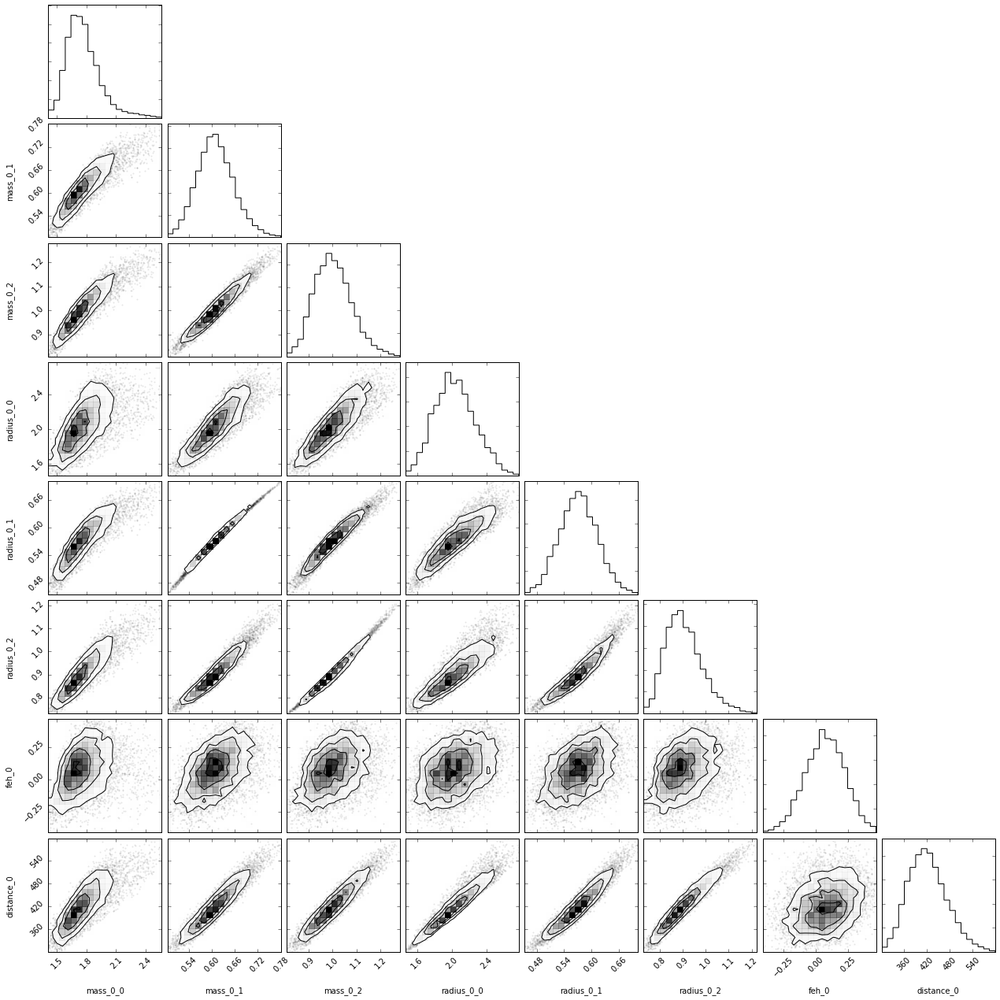

In [36]:
%matplotlib inline
#mod.corner(['mass_0_0', 'mass_0_1','logg_0_0','age_0','distance_0','AV_0']);
mod.corner_physical();

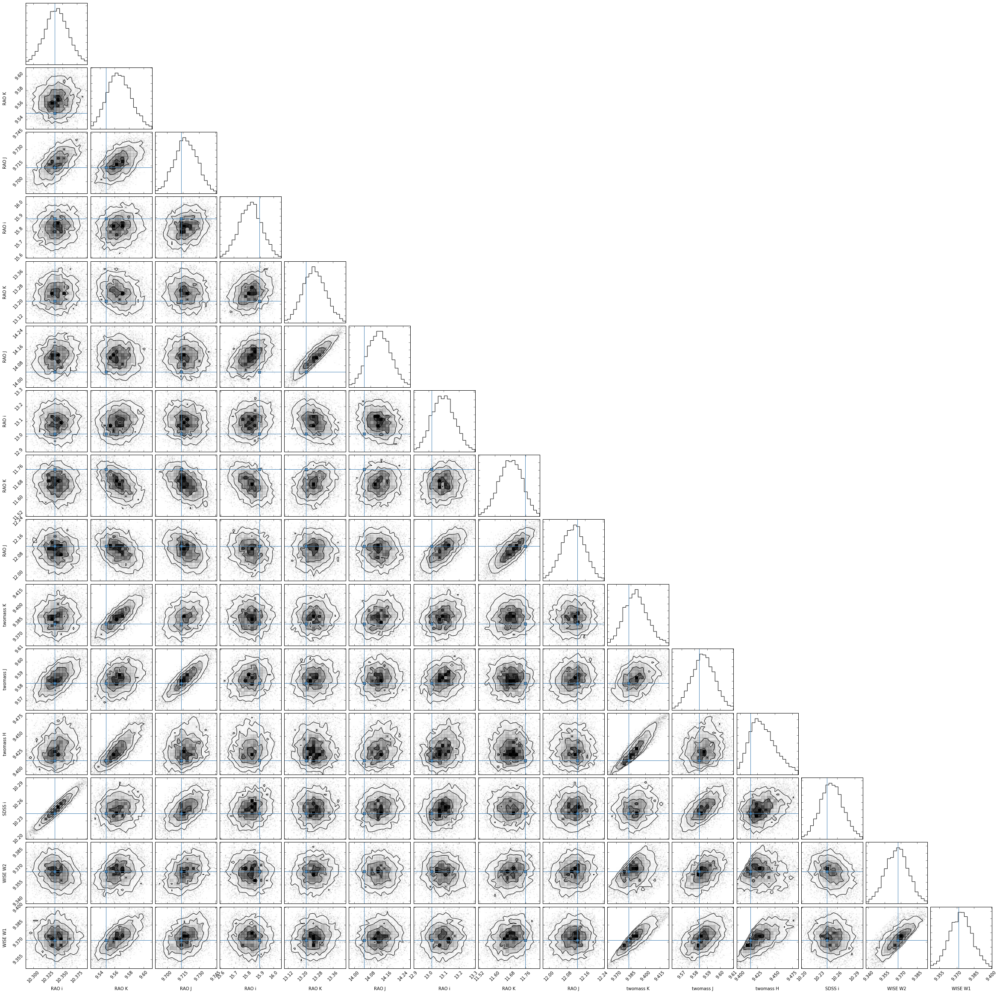

In [37]:
mod.corner_observed();

In [38]:
mod.obs.print_ascii(p=[M1,M2,M3, age1,feh,distance1,AV])

test-triplet
 ╚═ WISE W1=(9.37, 0.02) @(0.00, 0 [5.00]); model=9.25 (-19.7976315748)
    ╚═ WISE W2=(9.37, 0.02) @(0.00, 0 [5.00]); model=9.25 (-18.4663002127)
       ╚═ SDSS i=(10.24, 0.02) @(0.00, 0 [4.50]); model=10.16 (-8.21100691269)
          ╚═ twomass H=(9.42, 0.02) @(0.00, 0 [4.00]); model=9.29 (-18.9607453726)
             ╚═ twomass J=(9.58, 0.02) @(0.00, 0 [4.00]); model=9.48 (-13.542354716)
                ╚═ twomass K=(9.38, 0.02) @(0.00, 0 [4.00]); model=9.26 (-19.4579719538)
                   ╠═ RAO J=(9.71, 0.10) @(0.00, 0 [0.10]); model=9.71 (0)
                   ║  ╚═ RAO K=(9.55, 0.10) @(0.00, 0 [0.10]); model=9.55 (0)
                   ║     ╚═ RAO i=(10.34, 0.10) @(0.00, 0 [0.10]); model=10.34 (0)
                   ║        ╚═ 0_0, logg limits=(3.0, inf): [1.5, 8.6989700043360187, 0.0, 300, 0.1]
                   ╠═ RAO J=(14.05, 0.10) @(0.50, 100 [0.10]); model=14.05 (-1.57772181044e-28)
                   ║  ╚═ RAO K=(13.22, 0.10) @(0.50, 100 [0.10]); model

In [39]:
t2 = ObservationTree.from_df(df, name='triple2')
t2.define_models(dar, index=[0,1,2])
t2.print_ascii()

triple2
 ╚═ WISE W1=(9.37, 0.02) @(0.00, 0 [5.00])
    ╚═ WISE W2=(9.37, 0.02) @(0.00, 0 [5.00])
       ╚═ SDSS i=(10.24, 0.02) @(0.00, 0 [4.50])
          ╚═ twomass H=(9.42, 0.02) @(0.00, 0 [4.00])
             ╚═ twomass J=(9.58, 0.02) @(0.00, 0 [4.00])
                ╚═ twomass K=(9.38, 0.02) @(0.00, 0 [4.00])
                   ╠═ RAO J=(9.71, 0.10) @(0.00, 0 [0.10])
                   ║  ╚═ RAO K=(9.55, 0.10) @(0.00, 0 [0.10])
                   ║     ╚═ RAO i=(10.34, 0.10) @(0.00, 0 [0.10])
                   ║        ╚═ 0_0
                   ╠═ RAO J=(14.05, 0.10) @(0.50, 100 [0.10])
                   ║  ╚═ RAO K=(13.22, 0.10) @(0.50, 100 [0.10])
                   ║     ╚═ RAO i=(15.89, 0.10) @(0.50, 100 [0.10])
                   ║        ╚═ 1_0
                   ╚═ RAO J=(12.13, 0.10) @(1.20, 45 [0.10])
                      ╚═ RAO K=(11.76, 0.10) @(1.20, 45 [0.10])
                         ╚═ RAO i=(13.02, 0.10) @(1.20, 45 [0.10])
                            ╚═ 2_0


In [40]:
mod2 = StarModel(dar, obs=t2)
%timeit mod2.fit_multinest(basename='unassoc')

1 loop, best of 3: 5.71 s per loop


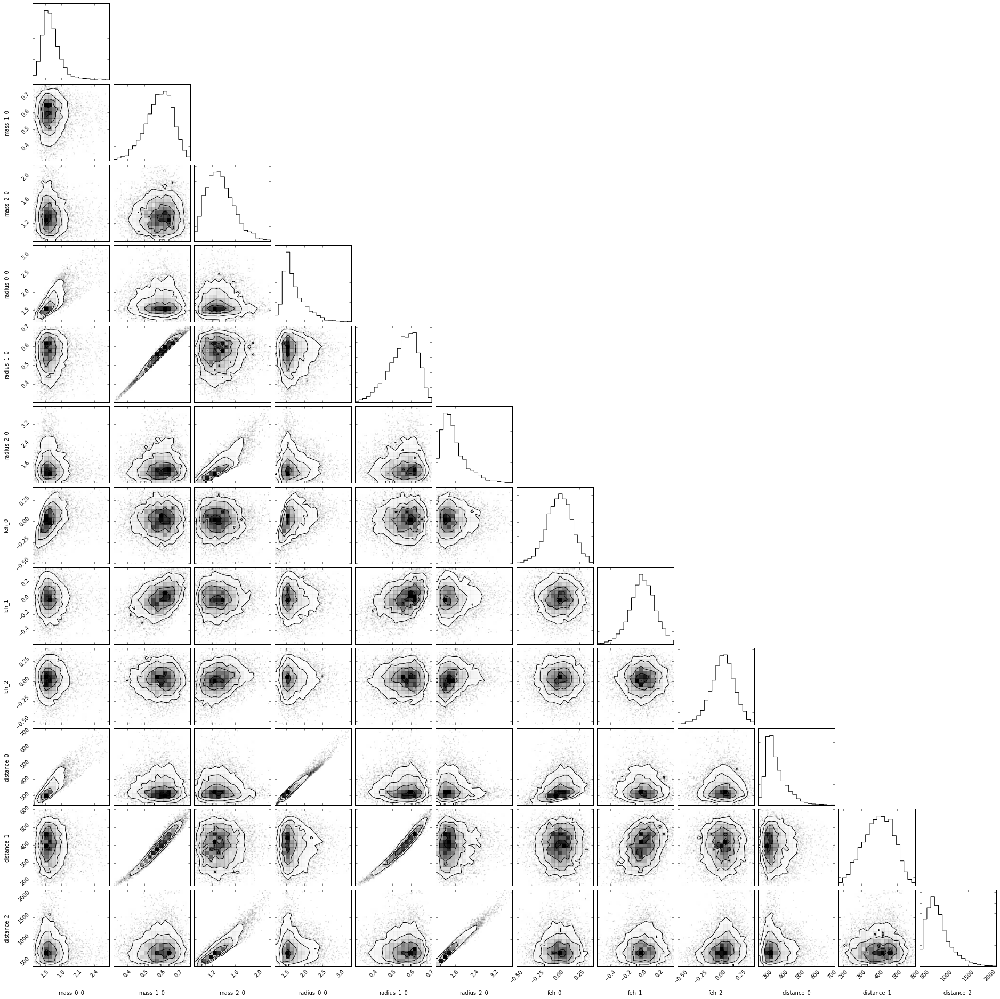

In [41]:
mod2.corner_physical();

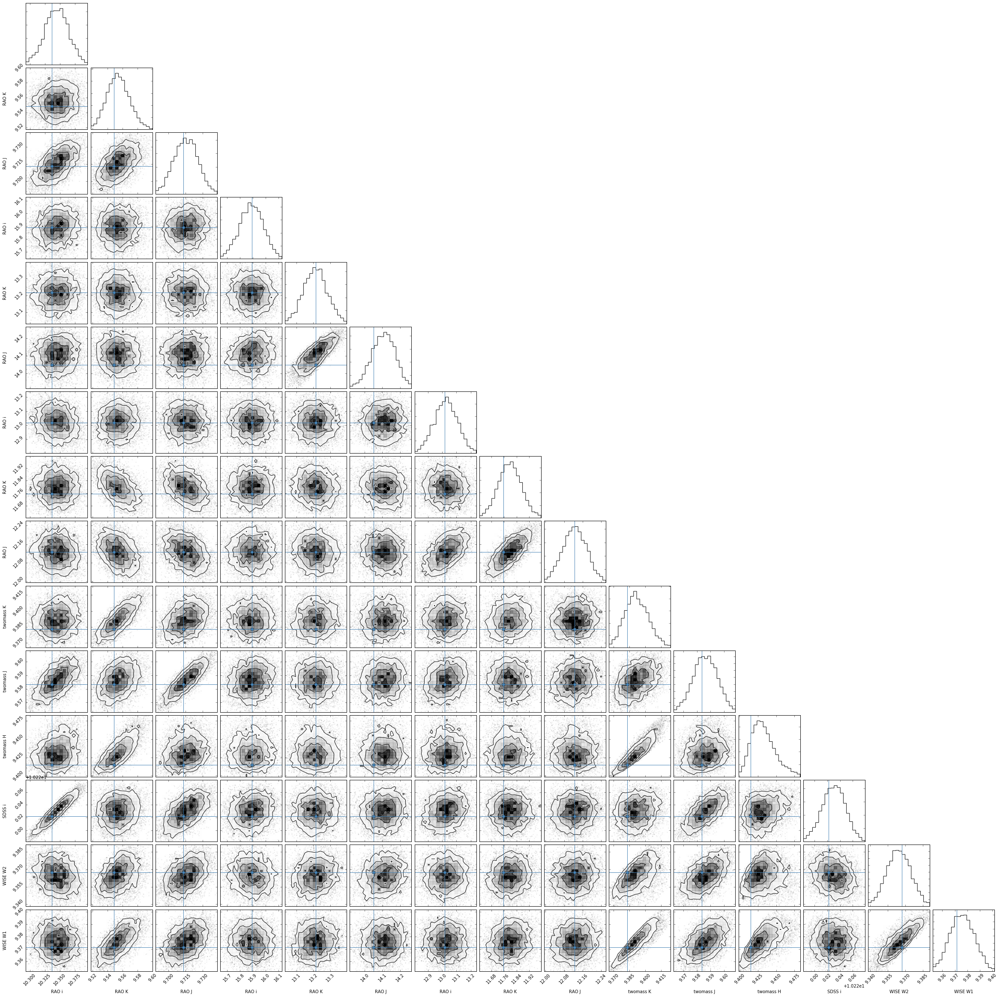

In [42]:
mod2.corner_observed();

In [43]:
mod.evidence

  analysing data from chains/triple.txt


(-40.73177671545998, 0.024064335219037204)

In [44]:
mod2.evidence

  analysing data from chains/unassoc.txt


(-71.28029492412504, 0.061671183849590666)

In [45]:
t3 = ObservationTree.from_df(df, name='triple3')
t3.define_models(dar, index=[0,0,1])
t3.print_ascii()

triple3
 ╚═ WISE W1=(9.37, 0.02) @(0.00, 0 [5.00])
    ╚═ WISE W2=(9.37, 0.02) @(0.00, 0 [5.00])
       ╚═ SDSS i=(10.24, 0.02) @(0.00, 0 [4.50])
          ╚═ twomass H=(9.42, 0.02) @(0.00, 0 [4.00])
             ╚═ twomass J=(9.58, 0.02) @(0.00, 0 [4.00])
                ╚═ twomass K=(9.38, 0.02) @(0.00, 0 [4.00])
                   ╠═ RAO J=(9.71, 0.10) @(0.00, 0 [0.10])
                   ║  ╚═ RAO K=(9.55, 0.10) @(0.00, 0 [0.10])
                   ║     ╚═ RAO i=(10.34, 0.10) @(0.00, 0 [0.10])
                   ║        ╚═ 0_0
                   ╠═ RAO J=(14.05, 0.10) @(0.50, 100 [0.10])
                   ║  ╚═ RAO K=(13.22, 0.10) @(0.50, 100 [0.10])
                   ║     ╚═ RAO i=(15.89, 0.10) @(0.50, 100 [0.10])
                   ║        ╚═ 0_1
                   ╚═ RAO J=(12.13, 0.10) @(1.20, 45 [0.10])
                      ╚═ RAO K=(11.76, 0.10) @(1.20, 45 [0.10])
                         ╚═ RAO i=(13.02, 0.10) @(1.20, 45 [0.10])
                            ╚═ 1_0


In [46]:
mod3 = StarModel(dar, obs=t3)
%timeit mod3.fit_multinest(basename='unassoc1')

1 loop, best of 3: 4.04 s per loop


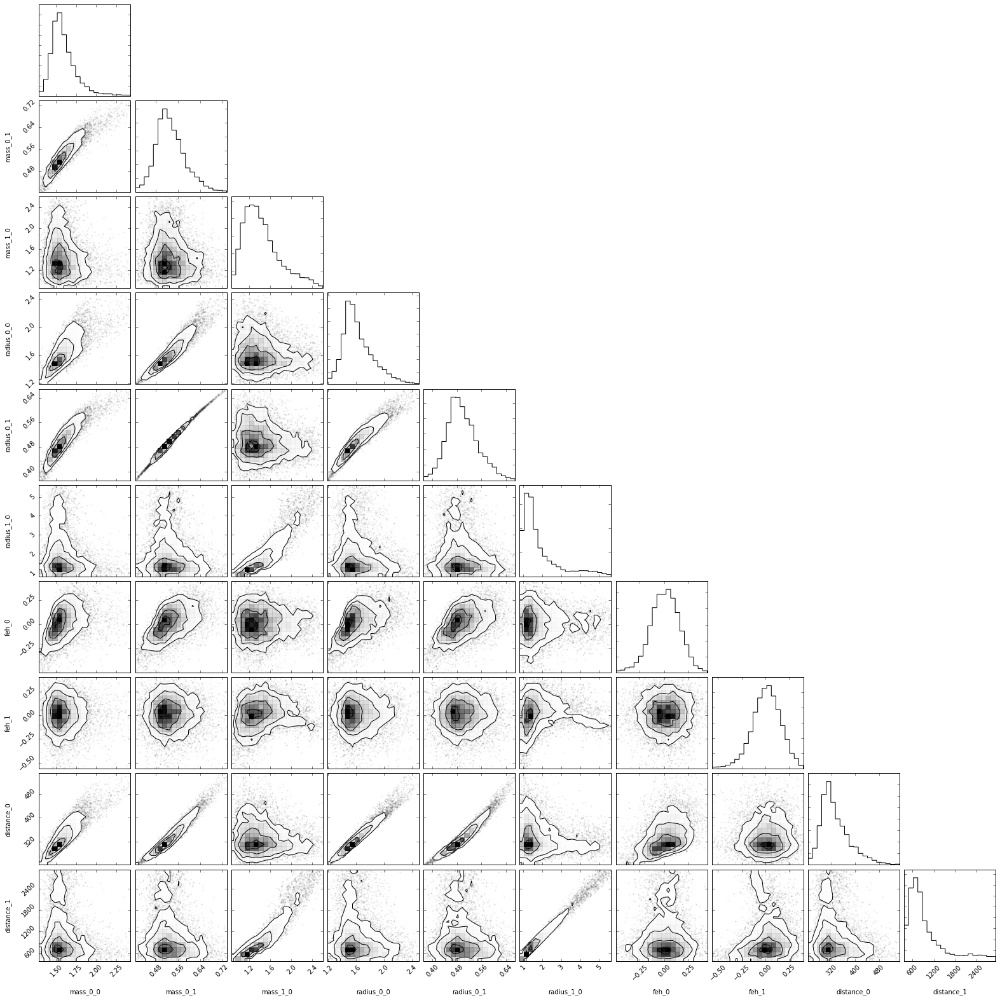

In [47]:
mod3.corner_physical();

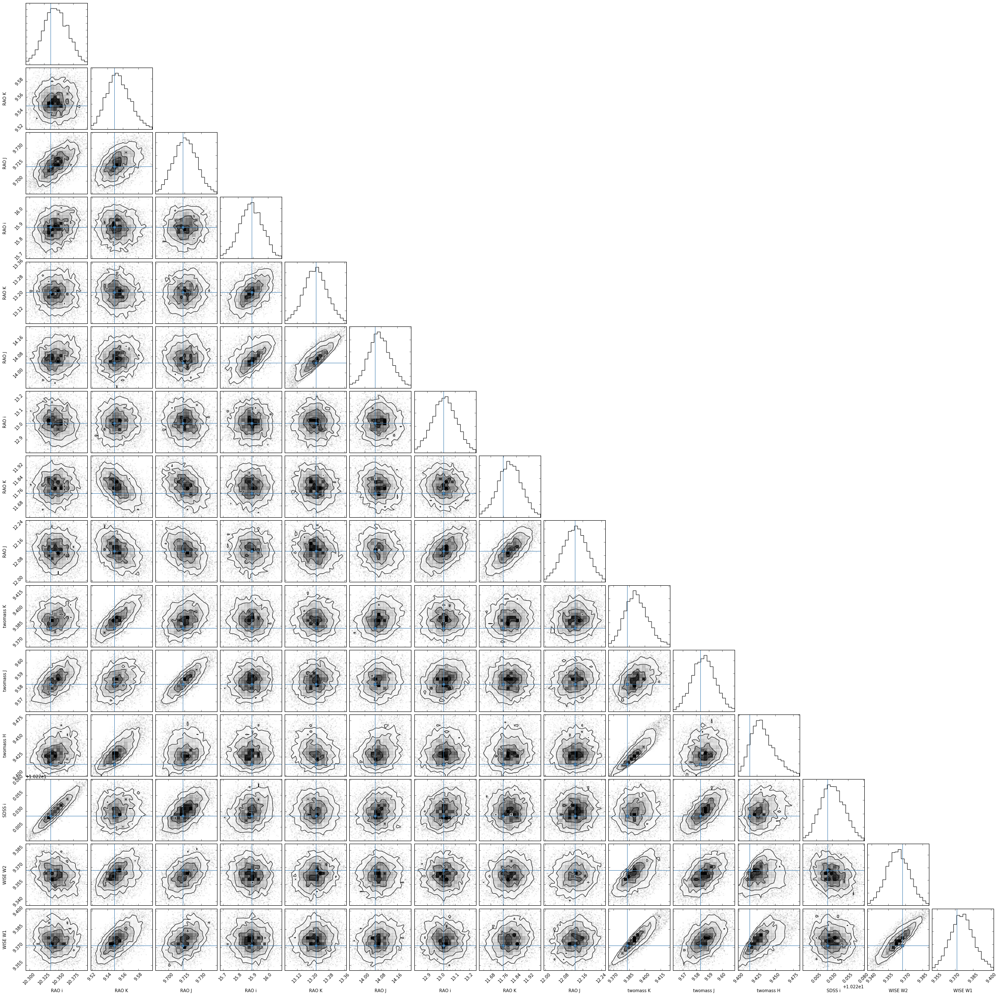

In [48]:
mod3.corner_observed();

In [49]:
t4 = ObservationTree.from_df(df, name='triple4')
t4.define_models(dar, index=[0,1,1])
t4.print_ascii()

triple4
 ╚═ WISE W1=(9.37, 0.02) @(0.00, 0 [5.00])
    ╚═ WISE W2=(9.37, 0.02) @(0.00, 0 [5.00])
       ╚═ SDSS i=(10.24, 0.02) @(0.00, 0 [4.50])
          ╚═ twomass H=(9.42, 0.02) @(0.00, 0 [4.00])
             ╚═ twomass J=(9.58, 0.02) @(0.00, 0 [4.00])
                ╚═ twomass K=(9.38, 0.02) @(0.00, 0 [4.00])
                   ╠═ RAO J=(9.71, 0.10) @(0.00, 0 [0.10])
                   ║  ╚═ RAO K=(9.55, 0.10) @(0.00, 0 [0.10])
                   ║     ╚═ RAO i=(10.34, 0.10) @(0.00, 0 [0.10])
                   ║        ╚═ 0_0
                   ╠═ RAO J=(14.05, 0.10) @(0.50, 100 [0.10])
                   ║  ╚═ RAO K=(13.22, 0.10) @(0.50, 100 [0.10])
                   ║     ╚═ RAO i=(15.89, 0.10) @(0.50, 100 [0.10])
                   ║        ╚═ 1_0
                   ╚═ RAO J=(12.13, 0.10) @(1.20, 45 [0.10])
                      ╚═ RAO K=(11.76, 0.10) @(1.20, 45 [0.10])
                         ╚═ RAO i=(13.02, 0.10) @(1.20, 45 [0.10])
                            ╚═ 1_1


In [50]:
mod4 = StarModel(dar, obs=t4)
%timeit mod4.fit_multinest(basename='unassoc2')

The slowest run took 2242.96 times longer than the fastest. This could mean that an intermediate result is being cached.
1 loop, best of 3: 2.76 s per loop


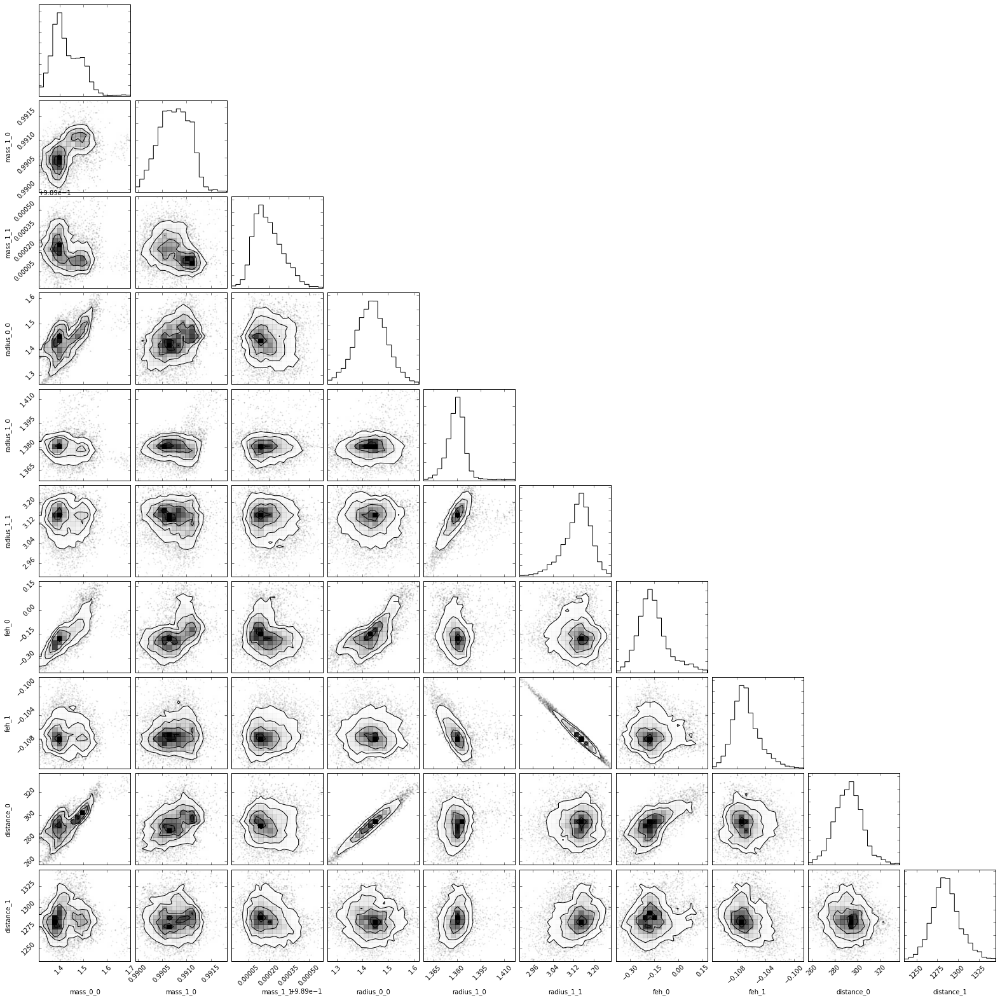

In [51]:
mod4.corner_physical();

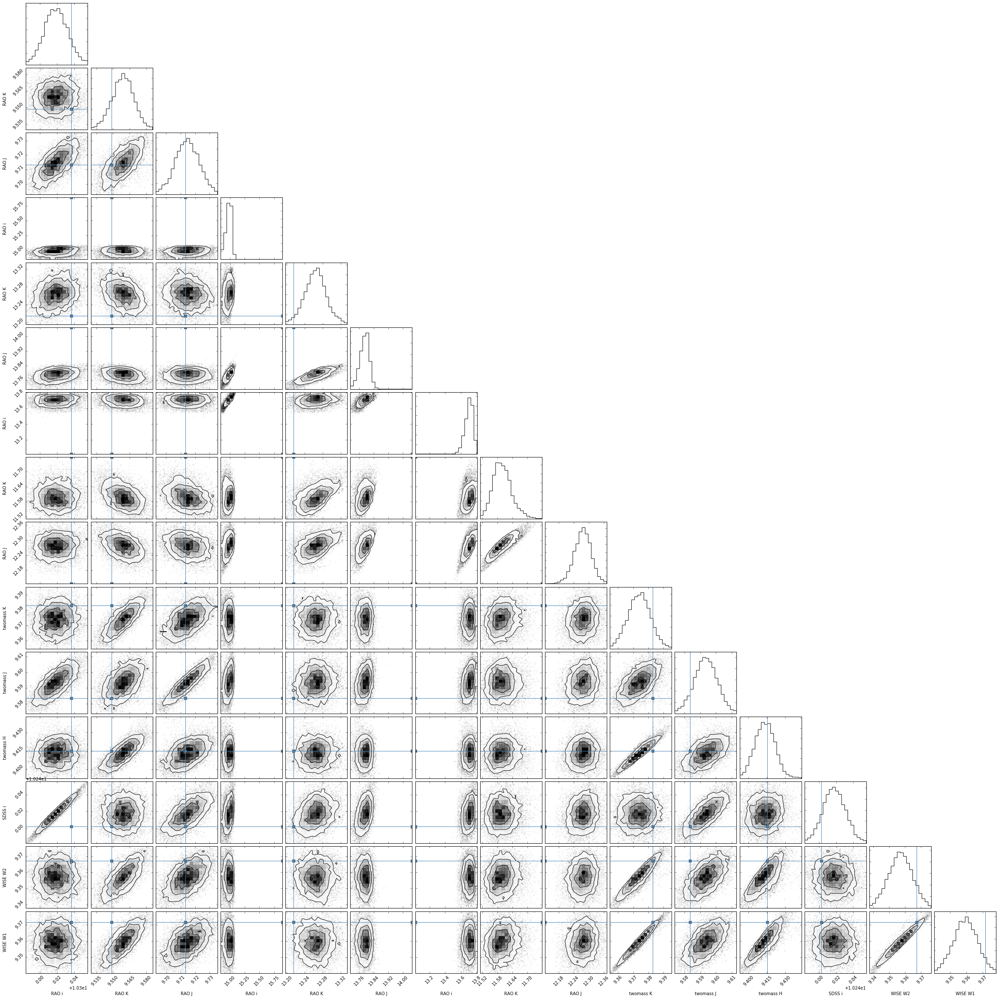

In [52]:
mod4.corner_observed();

In [53]:
mod3.evidence

  analysing data from chains/unassoc1.txt


(-54.75905388668428, 0.1869940618076296)

In [54]:
mod4.evidence

  analysing data from chains/unassoc2.txt


(-155.68921933371104, 0.010346854351743694)

In [55]:
t5 = ObservationTree.from_df(df, name='triple5')
t5.define_models(dar, index=[1,0,1])
t5.print_ascii()

triple5
 ╚═ WISE W1=(9.37, 0.02) @(0.00, 0 [5.00])
    ╚═ WISE W2=(9.37, 0.02) @(0.00, 0 [5.00])
       ╚═ SDSS i=(10.24, 0.02) @(0.00, 0 [4.50])
          ╚═ twomass H=(9.42, 0.02) @(0.00, 0 [4.00])
             ╚═ twomass J=(9.58, 0.02) @(0.00, 0 [4.00])
                ╚═ twomass K=(9.38, 0.02) @(0.00, 0 [4.00])
                   ╠═ RAO J=(9.71, 0.10) @(0.00, 0 [0.10])
                   ║  ╚═ RAO K=(9.55, 0.10) @(0.00, 0 [0.10])
                   ║     ╚═ RAO i=(10.34, 0.10) @(0.00, 0 [0.10])
                   ║        ╚═ 1_0
                   ╠═ RAO J=(14.05, 0.10) @(0.50, 100 [0.10])
                   ║  ╚═ RAO K=(13.22, 0.10) @(0.50, 100 [0.10])
                   ║     ╚═ RAO i=(15.89, 0.10) @(0.50, 100 [0.10])
                   ║        ╚═ 0_0
                   ╚═ RAO J=(12.13, 0.10) @(1.20, 45 [0.10])
                      ╚═ RAO K=(11.76, 0.10) @(1.20, 45 [0.10])
                         ╚═ RAO i=(13.02, 0.10) @(1.20, 45 [0.10])
                            ╚═ 1_1


In [56]:
mod5 = StarModel(dar, obs=t5)
%timeit mod5.fit_multinest(basename='unassoc5')

The slowest run took 1769.50 times longer than the fastest. This could mean that an intermediate result is being cached.
1 loop, best of 3: 3.43 s per loop


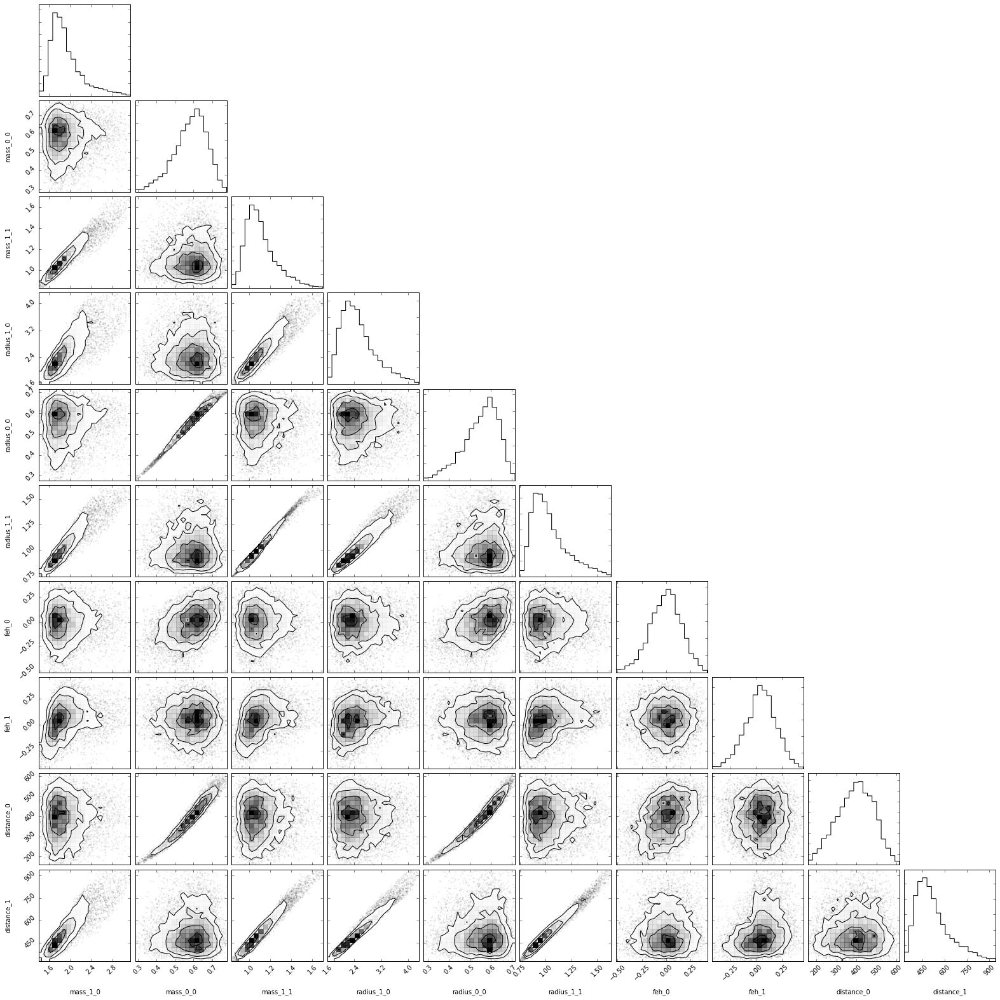

In [57]:
mod5.corner_physical();

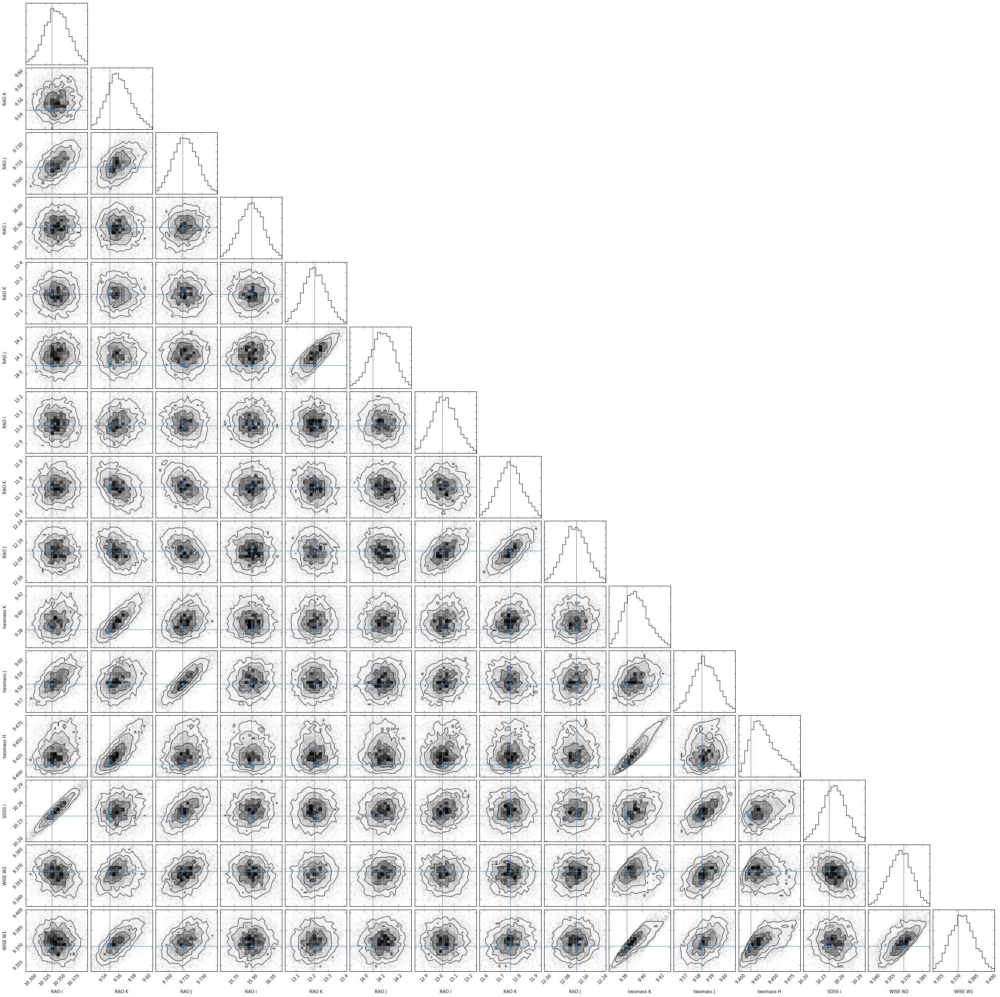

In [58]:
mod5.corner_observed();

In [59]:
mod5.evidence

  analysing data from chains/unassoc5.txt


(-55.41749870451816, 0.04969589184672613)